# Gen-L-Video Demo
Implementation of [Gen-L-Video: Multi-Text to Long Video Generation via Temporal Co-Denoising](https://arxiv.org/abs/2305.18264).


---
arXiv: https://arxiv.org/abs/2305.18264

code: https://github.com/G-U-N/Gen-L-Video

project page: https://g-u-n.github.io/projects/gen-long-video/index.html

If you have any questions about **Gen-L-Video**, please contact the author [Fu-Yun Wang](g-u-n.github.io).    
email: [wangfuyun@smail.nju.edu.cn](mailto:wangfuyun)


## Installation

In [ ]:
!nvidia-smi --query-gpu=name,memory.total,memory.free --format=csv,noheader

Tesla T4, 15360 MiB, 15101 MiB


In [ ]:
!git clone https://github.com/G-U-N/Gen-L-Video.git


import sys
sys.path.append(".")
sys.path.append('./Gen-L-Video')

%pip install -q -U --pre triton
%pip install -q diffusers[torch]==0.15.1 transformers==4.27.4 bitsandbytes==0.35.4 \
decord accelerate omegaconf einops ftfy gradio imageio-ffmpeg xformers safetensors==0.3.0

fatal: destination path 'Gen-L-Video' already exists and is not an empty directory.


## Download Pretrained Models

In [ ]:
import os
os.makedirs("weights/T2I-Adapter/models",exist_ok=True)

In [ ]:
! git clone https://huggingface.co/CompVis/stable-diffusion-v1-4
! wget https://huggingface.co/YueMafighting/FollowYourPose_v1/resolve/main/followyourpose_checkpoint-1000/pytorch_model.bin
! rm stable-diffusion-v1-4/unet/diffusion_pytorch_model.bin stable-diffusion-v1-4/unet/diffusion_pytorch_model.safetensors
! rm stable-diffusion-v1-4/text_encoder/model.safetensors stable-diffusion-v1-4/vae/diffusion_pytorch_model.safetensors 
! mv pytorch_model.bin stable-diffusion-v1-4/unet/diffusion_pytorch_model.bin
! wget https://huggingface.co/YueMafighting/FollowYourPose_v1/resolve/main/pose_encoder.pth
! mv pose_encoder.pth weights/T2I-Adapter/models

Cloning into 'stable-diffusion-v1-4'...
remote: Enumerating objects: 741, done.
remote: Counting objects: 100% (15/15), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 741 (delta 4), reused 12 (delta 3), pack-reused 726
Receiving objects: 100% (741/741), 683.08 KiB | 17.51 MiB/s, done.
Resolving deltas: 100% (124/124), done.
Filtering content: 100% (8/8), 10.20 GiB | 51.12 MiB/s, done.
--2023-06-04 16:34:17--  https://huggingface.co/YueMafighting/FollowYourPose_v1/resolve/main/followyourpose_checkpoint-1000/pytorch_model.bin
Resolving huggingface.co (huggingface.co)... 18.155.68.121, 18.155.68.38, 18.155.68.44, ...
Connecting to huggingface.co (huggingface.co)|18.155.68.121|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs.huggingface.co/repos/0e/21/0e2180ba44e2357811cccf195e161b24a1cd992899109adfc7bbc328f33d9d41/70f18a518cc739f2dc6cb1f7e7c36d853bb3f123a5ffb7094cbc65cb413809b4?response-content-disposition=attachment%3B+f

## Inference

In [ ]:
import importlib
from omegaconf import OmegaConf

module_name = 'follow-your-pose-long' 
module = importlib.import_module(module_name)

conf_name = 'Gen-L-Video/configs/follow-your-pose-long/group.yaml'
conf = OmegaConf.load(conf_name)


function_name = 'main' 
function = getattr(module, function_name)

conf["pretrained_model_path"] = "./stable-diffusion-v1-4"
# 调用函数
conf["train_data"]["video_path"] = "Gen-L-Video/c_data/mmpose/group.mp4"
conf["validation_data"]["stride"] = 8
conf["validation_data"]["prompts"] = ["Stormtroopers on the sea"]


function(**conf)
# Generate a gif/video about 10 seconds (with each seconds 8 frames)

INFO:follow-your-pose-long:Distributed environment: NO
Num processes: 1
Process index: 0
Local process index: 0
Device: cuda

Mixed precision type: fp16

{'dynamic_thresholding_ratio', 'prediction_type', 'clip_sample_range', 'sample_max_value', 'thresholding'} was not found in config. Values will be initialized to default values.
{'norm_num_groups'} was not found in config. Values will be initialized to default values.
{'mid_block_type', 'only_cross_attention', 'upcast_attention', 'resnet_time_scale_shift', 'class_embed_type', 'use_linear_projection', 'dual_cross_attention', 'num_class_embeds'} was not found in config. Values will be initialized to default values.
{'dynamic_thresholding_ratio', 'prediction_type', 'clip_sample_range', 'sample_max_value', 'thresholding'} was not found in config. Values will be initialized to default values.
INFO:follow-your-pose-long:inference pixel values


80
[(0, 16), (8, 24), (16, 32), (24, 40), (32, 48), (40, 56), (48, 64), (56, 72), (64, 80)]


/content/./Gen-L-Video/glv/pipelines/pipeline_fyp_long.py:458: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet3DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet3DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  num_channels_latents = self.unet.in_channels


  0%|          | 0/50 [00:00<?, ?it/s]

INFO:follow-your-pose-long:Saved samples to ./results/follow-your-pose-t2v/group//samples/sample.gif


## Display

MoviePy - Building file /content/Gen-L-Video/c_data/mmpose/group.gif with imageio.


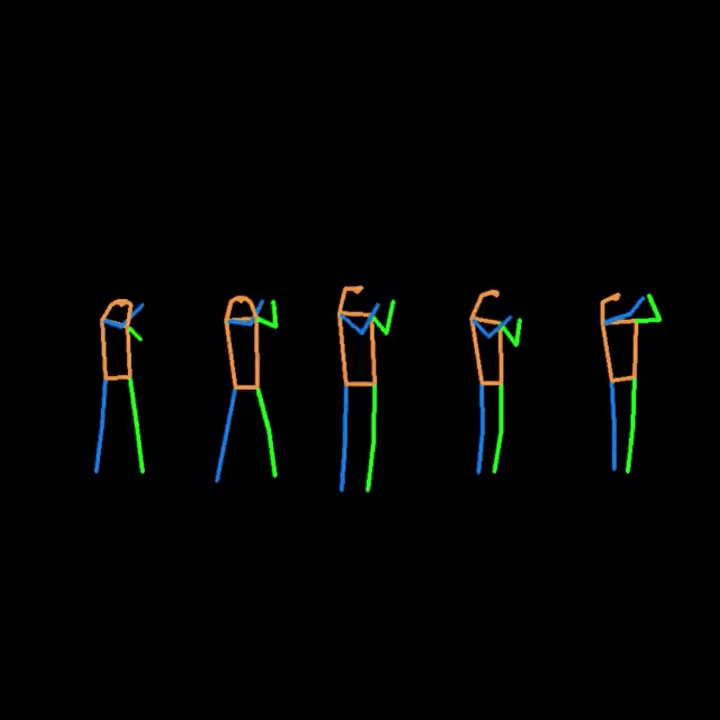

In [ ]:
import imageio
from moviepy.editor import *

def convert_mp4_to_gif(mp4_file, gif_file):
    video = VideoFileClip(mp4_file)
    video.write_gif(gif_file)
convert_mp4_to_gif("/content/Gen-L-Video/c_data/mmpose/group.mp4", "/content/Gen-L-Video/c_data/mmpose/group.gif")
from IPython.display import Image, display
display(Image(filename="/content/Gen-L-Video/c_data/mmpose/group.gif"))

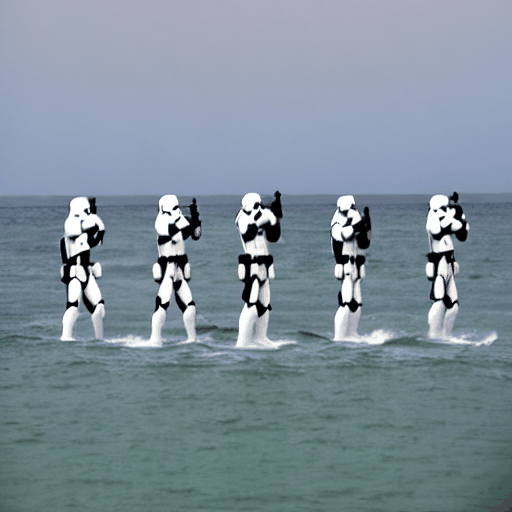

In [ ]:
from IPython.display import Image, display
display(Image(filename="/content/results/follow-your-pose-t2v/group/samples/sample.gif"))

In [ ]:
exit()